# Triphasic response

In [2]:
%pylab inline

# General functions #
import sys
sys.path.append('/Users/alexandre/Desktop/INRIA/Prog/Python/')
from utils import bokeh_data_frame
from utils import ToHtmlTableColumns, DataFrame_to_html

from utils import replace_string_in_list

import cPickle as pickle
import pandas as pd
import seaborn
import string



Populating the interactive namespace from numpy and matplotlib


In [3]:
list_df_Voltage_index_OHDA = pickle.load(open("list_df_Voltage_index_OHDA.p", "rb"))

In [2]:
from parameters import *
from Model_Basal_ganglia_Triphasic import *


Couldn't import dot_parser, loading of dot files will not be possible.


## Convolution on 5 sham cells

In [3]:
# -------- Specific part in parameters to choose cell type ------- #
cell_type = 'sham'
params_dictionary = pickle.load(open("params_fitted_dictionary_2015_06_sham_A.p", "rb"))

rel_path_data = '/../../Data/2015_05_' + cell_type + '_cells/'
pickle_convolution_data = 'Convolution_Asier_data_' + cell_type + '.p'

datas = pd.read_pickle(pickle_convolution_data)

# Mean of data is the last column #
data_to_fit = datas.iloc[:,-1].dropna() # dropna() to avoid RuntimeWarning because of NaNs.
  
df_convolution = datas


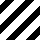
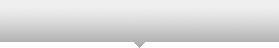
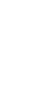
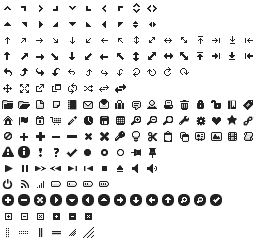
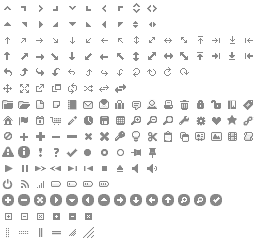
...
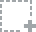
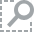
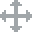
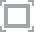
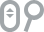

""


In [4]:
DataFrame_to_html(df_convolution, plot_width = 800)

In [5]:
r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)
   

In [6]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [7]:
Title = 'Control condition'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]





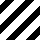
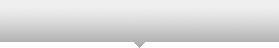
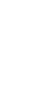
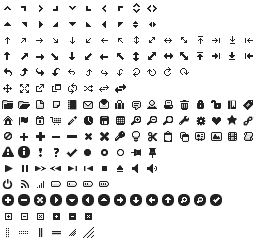
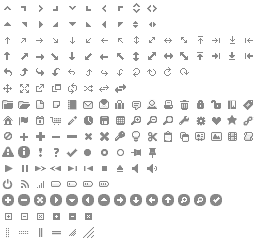
...
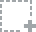
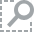
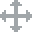
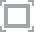
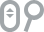

In [8]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

## Graph of connexions

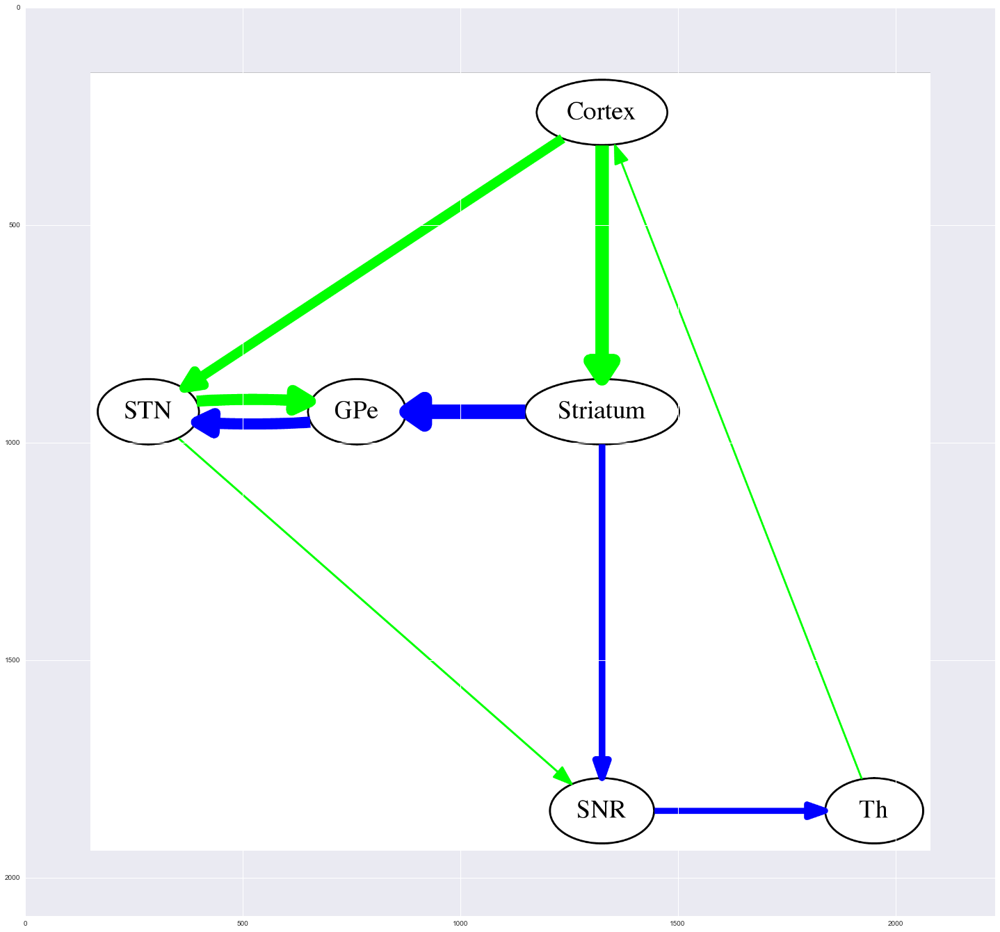

In [9]:
output_png_w = pydot_networkx_neato_graph(params_dictionary, node_position=node_position)

plt.figure(figsize=(25.0,25.0))
plt.imshow(plt.imread(output_png_w))



$r_i$ is the observed activity of each neuron i; it's the sum of all activities received from other neurons and of the basal activity, computed with a linear function $F$. It's integrated with a time constant $\tau_{EPSC}$.

$I_{basal_i}$ is the basal activity received by neuron i.

$S_{ext_i}$ is the input from sources outside the network to neuron i.

$w_{(i,j)}$ and $\tau_{delay_{(i,j)}}$ are respectively the weight and the delay of the connection between the neuron i and the neuron j.


$\tau_{EPSC} \frac{dr_i(t)}{dt} = F(I_{basal_i} + \sum\limits_{j = 1}^n r_{j}(t - \tau_{delay_{(i,j)}}) \times w_{(i,j)} + S_{ext_i} ), \text{with n the number of neurons}$


$F(x) = \left \{ \begin{array}{l}
\text{x if } x >= 0\\
\text{0 if } x < 0
\end{array} 
\right.$

In [10]:
connexion_ignored = {'Striatum' : ['SNR']}

r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)

In [11]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [12]:
Title = 'Without direct pathway'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]





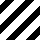
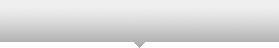
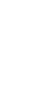
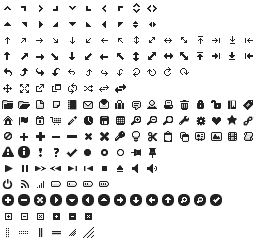
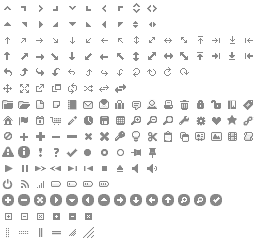
...
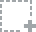
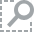
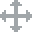
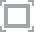
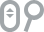

In [13]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

In [14]:
connexion_ignored = {'Striatum' : ['GPe']}

r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)

In [15]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [16]:
Title = 'Without indirect pathway'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]




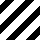
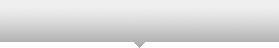
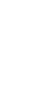
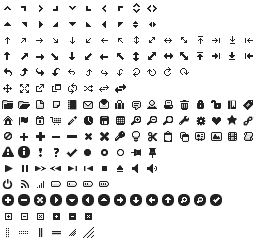
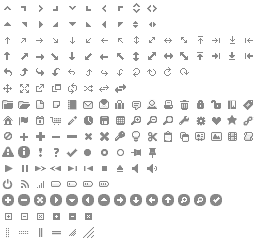
...
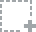
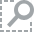
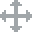
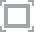
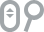

In [17]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

In [18]:
connexion_ignored = {'Cortex' : ['STN']}

r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)

In [19]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [20]:
Title = 'Without hyper-direct pathway'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]




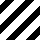
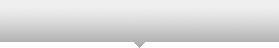
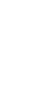
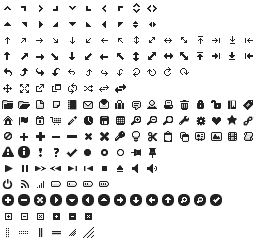
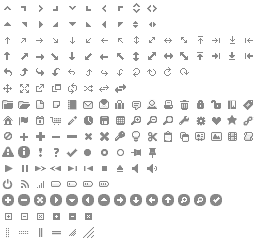
...
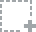
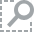
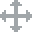
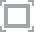
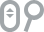

In [21]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

In [22]:
connexion_ignored = {'Cortex' : ['Striatum']}
#connexion_ignored = {'Striatum' : ['GPe', 'SNR']}

r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)


In [23]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [24]:
Title = 'Only hyper-direct pathway'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]




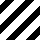
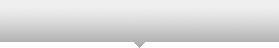
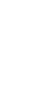
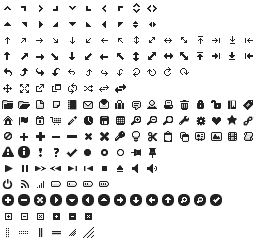
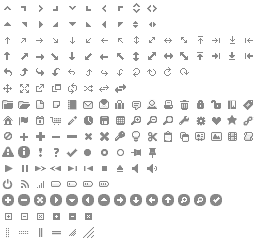
...
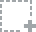
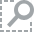
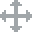
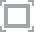
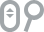

In [25]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

In [26]:
connexion_ignored = {'STN' : ['SNR']}
connexion_ignored = {'Striatum' : ['GPe'],
                     'Cortex' : ['STN']}

r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)


In [27]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [28]:
Title = 'Only direct pathway'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]





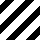
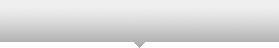
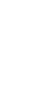
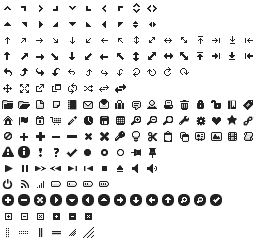
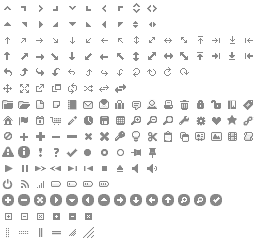
...
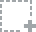
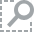
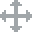
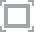
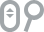

In [29]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

In [30]:
connexion_ignored = {'Striatum' : ['SNR'],
                     'Cortex' : ['STN']
                     }

r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)

In [31]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [32]:
Title = 'Only indirect pathway'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]




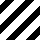
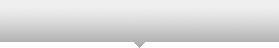
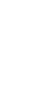
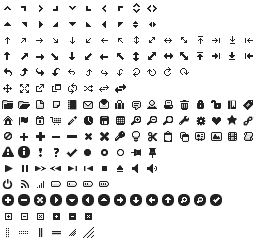
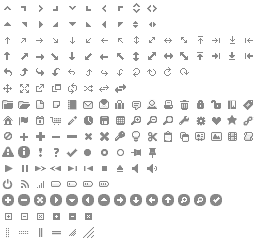
...
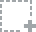
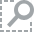
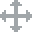
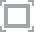
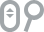

In [33]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

## Convolution on 5 6ohda cells

### Three clusters of responses

#### Cluster with a response of 3 phases

In [34]:
# -------- Specific part in parameters to choose cell type ------- #
from parameters import *
cell_type = '6ohda_3_phase'
params_dictionary = pickle.load(open("params_fitted_dictionary_2015_07_6OHDA_3_phase_A.p", "rb"))

rel_path_data = '/../../Data/2015_05_' + cell_type + '_cells/'
pickle_convolution_data = 'Convolution_Asier_data_' + cell_type + '.p'

datas = pd.read_pickle(pickle_convolution_data)

# Mean of data is the last column #
data_to_fit = datas.iloc[:,-1].dropna() # dropna() to avoid RuntimeWarning because of NaNs.
  
df_convolution = datas





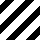
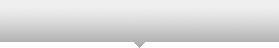
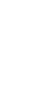
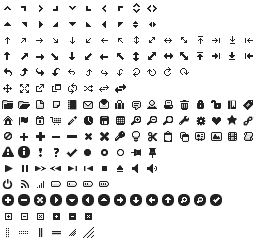
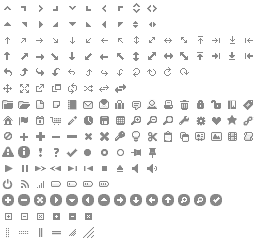
...
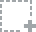
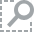
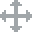
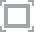
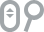

""


In [35]:
DataFrame_to_html(df_convolution, plot_width = 800)

In [36]:

r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)
   

In [37]:
# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

In [38]:
Title = '6-OHDA condition and 3 phase data'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]




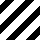
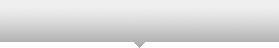
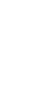
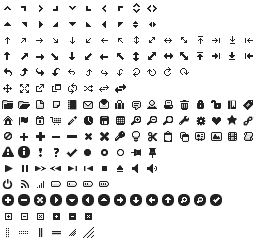
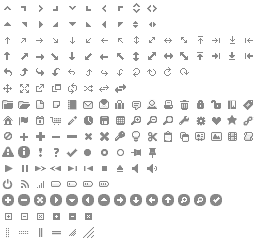
...
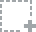
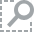
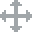
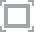
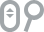

In [39]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

#### Cluster with a response of 1 phase

In [40]:
# -------- Specific part in parameters to choose cell type ------- #
from parameters import *
cell_type = '6ohda_1_phase'
params_dictionary = pickle.load(open("params_fitted_dictionary_2015_07_6OHDA_1_phase_A.p", "rb"))

rel_path_data = '/../../Data/2015_05_' + cell_type + '_cells/'
pickle_convolution_data = 'Convolution_Asier_data_' + cell_type + '.p'

datas = pd.read_pickle(pickle_convolution_data)

# Mean of data is the last column #
data_to_fit = datas.iloc[:,-1].dropna() # dropna() to avoid RuntimeWarning because of NaNs.
  
df_convolution = datas




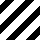
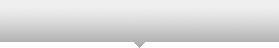
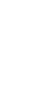
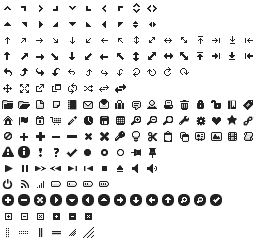
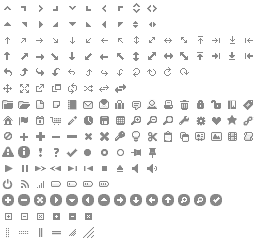
...
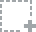
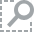
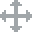
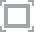
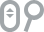

""


In [41]:
DataFrame_to_html(df_convolution, plot_width = 800)

In [42]:
r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)

# Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]

Title = '6-OHDA condition and 1 phase data'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]




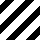
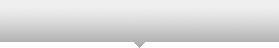
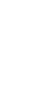
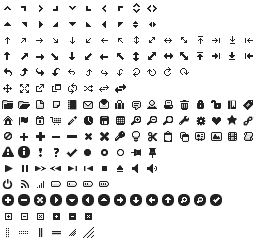
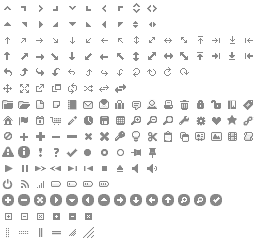
...
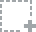
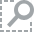
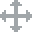
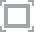
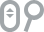

In [43]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

## Cluster of unknown type of response

In [44]:
# -------- Specific part in parameters to choose cell type ------- #
from parameters import *
cell_type = '6ohda_unknown'
params_dictionary = pickle.load(open("params_fitted_dictionary_2015_07_6OHDA_unknown_A.p", "rb"))

rel_path_data = '/../../Data/2015_05_' + cell_type + '_cells/'
pickle_convolution_data = 'Convolution_Asier_data_' + cell_type + '.p'

datas = pd.read_pickle(pickle_convolution_data)

# Mean of data is the last column #
data_to_fit = datas.iloc[:,-1].dropna() # dropna() to avoid RuntimeWarning because of NaNs.
  
df_convolution = datas





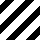
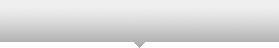
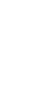
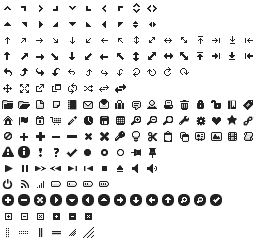
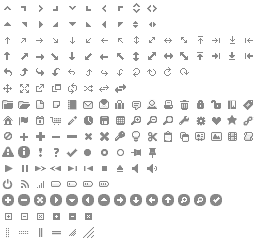
...
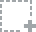
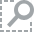
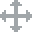
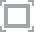
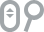

""


In [45]:
DataFrame_to_html(df_convolution, plot_width = 800)

In [46]:
r = sc.solve(params_dictionary,step,t,regions,connexion_ignored,dict_get_default,ext_stim,t_to_steady_state)

# numpy.ndarray() to DataFrame
r = pd.DataFrame(r, index = t, columns = regions)
   # Simulation synchronized with Asier data #
simu_data = r.copy()
simu_data.index = (r.index.values - t_adjust)
simu_data = simu_data[simu_data.index > 0]
Title = '6-OHDA condition and trash-category data'
xlab = 'Time in msec'
ylab = 'Instantaneous frequency'

list_data_x = [data_to_fit.index, simu_data[region_fitted].index, simu_data[region_stimulated].index]

list_data_y = [data_to_fit, simu_data[region_fitted], simu_data[region_stimulated]]




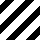
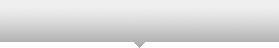
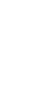
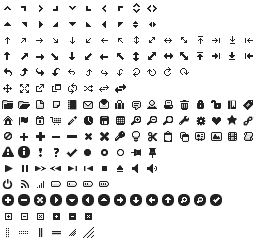
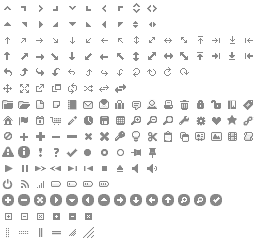
...
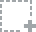
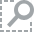
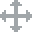
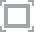
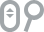

In [47]:
bokeh_data_frame(list_data_x, list_data_y, Title, xlab, ylab)

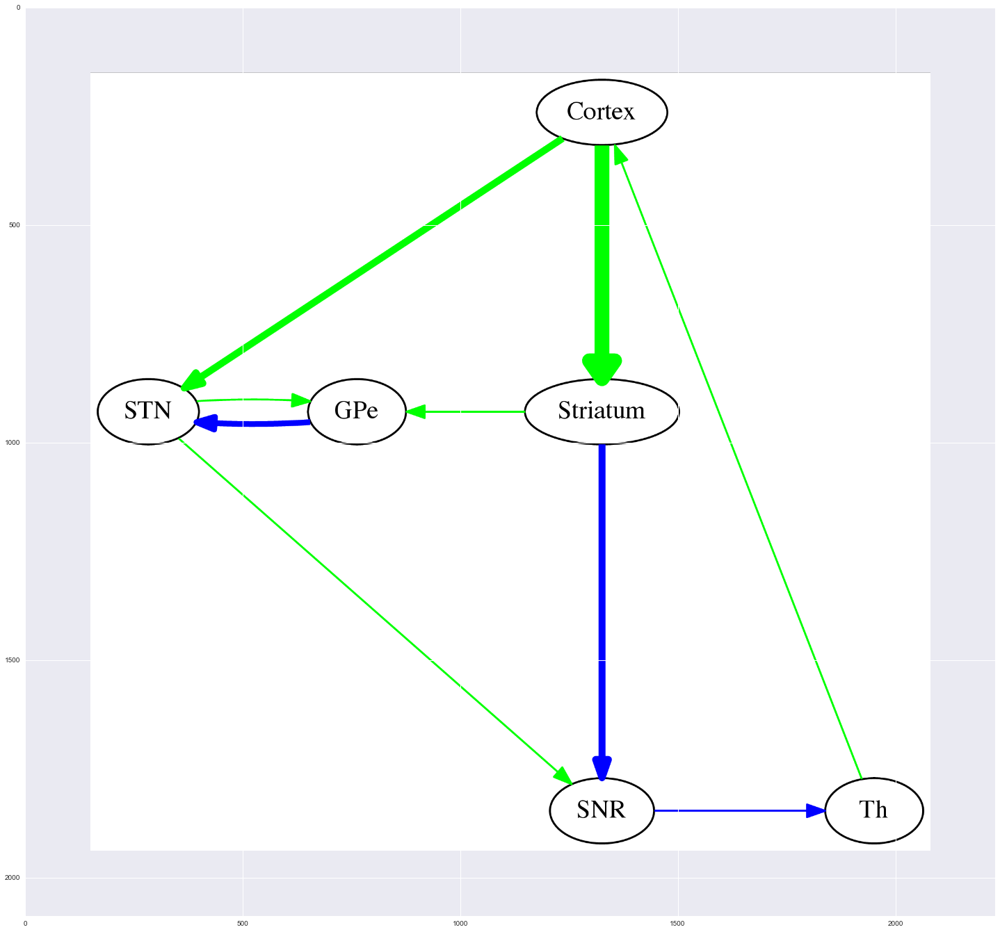

In [48]:
output_png_w = pydot_networkx_neato_graph(params_dictionary, node_position=node_position)

plt.figure(figsize=(25.0,25.0))
plt.imshow(plt.imread(output_png_w))


## Parameters' distribution over ten repetition of fitting

In [49]:
# Get data #
data_rep_sham = pd.read_pickle('df_fit_repetition_sham_B.p')
data_rep_3_phases = pd.read_pickle('df_fit_repetition_3_phase_C.p')
data_rep_1_phase = pd.read_pickle('df_fit_repetition_1_phase_C.p')
data_rep_unknown = pd.read_pickle('df_fit_repetition_unknown_C.p')

import re # Library for regular expression

# Select columns of weight #
df_W_sham = data_rep_sham.select(lambda x: re.search('_w$', x) is not None, axis=1) # I select which key end by "_w"
df_W_3_phases = data_rep_3_phases.select(lambda x: re.search('_w$', x) is not None, axis=1) # I select which key end by "_w"
df_W_1_phase = data_rep_1_phase.select(lambda x: re.search('_w$', x) is not None, axis=1) # I select which key end by "_w"
df_W_unknown = data_rep_unknown.select(lambda x: re.search('_w$', x) is not None, axis=1) # I select which key end by "_w"

# Concatenation #
df_W_concat = pd.concat([df_W_sham,df_W_3_phases, df_W_1_phase, df_W_unknown], axis = 1,keys=['SHAM','3_phases', '1_phase', 'unknown'])

# Number parameters #
nb_parameters_data = len(df_W_sham.keys())


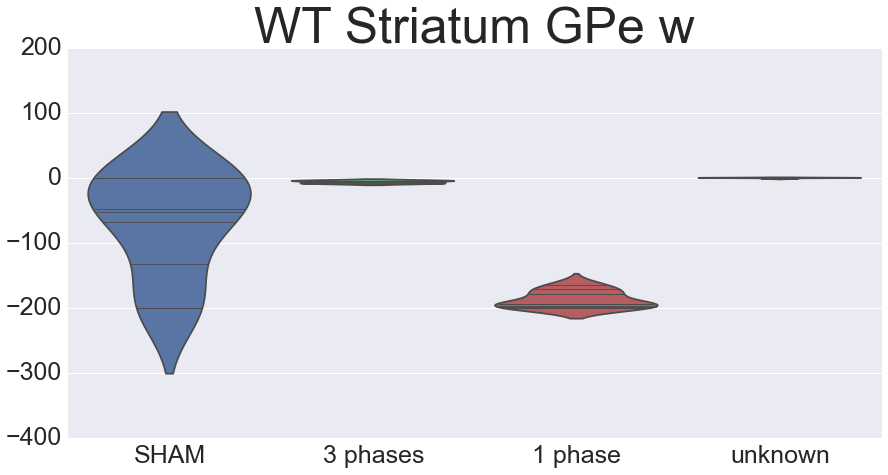

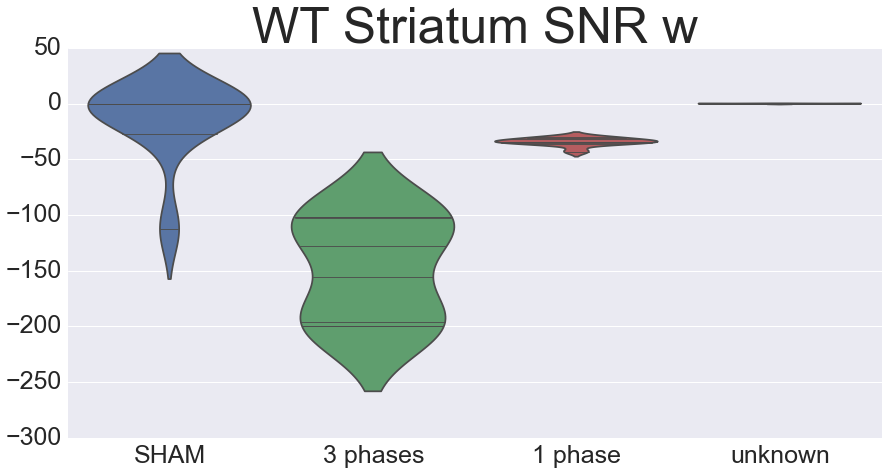

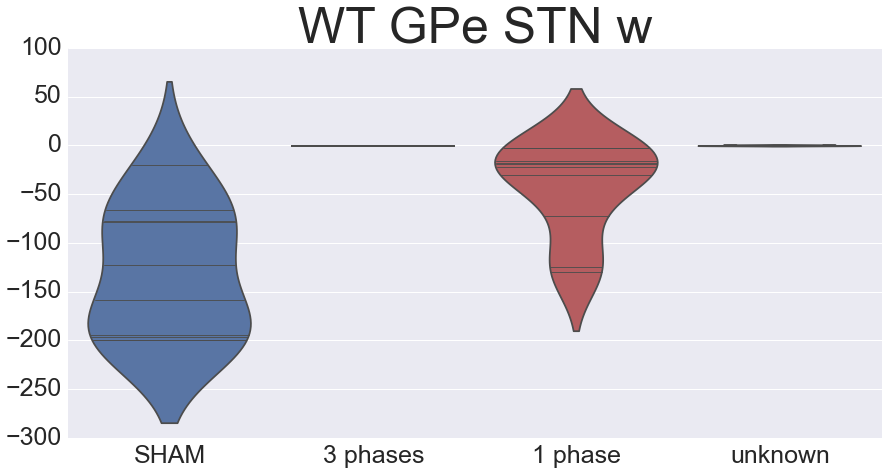

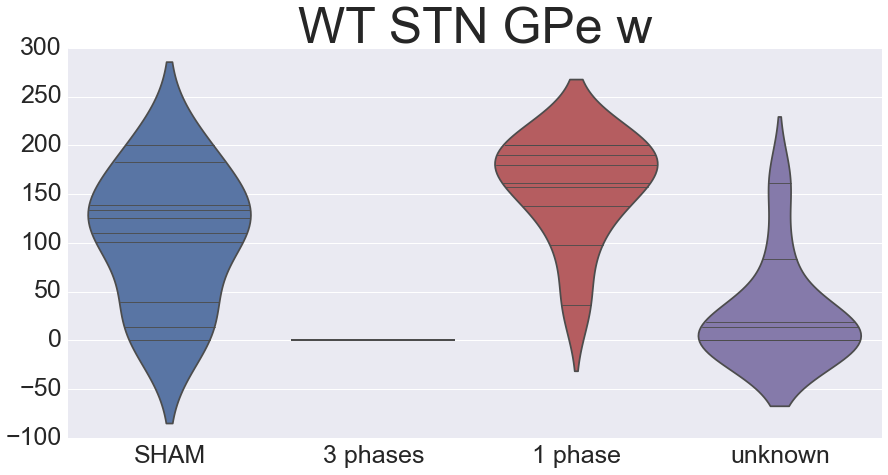

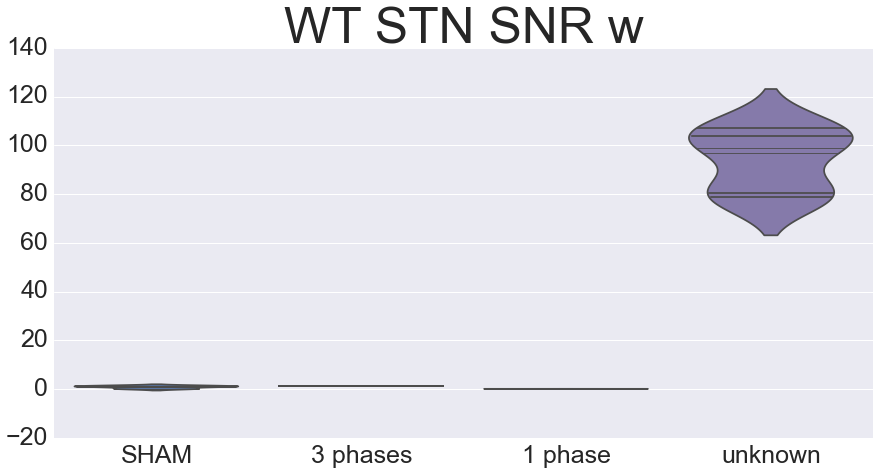

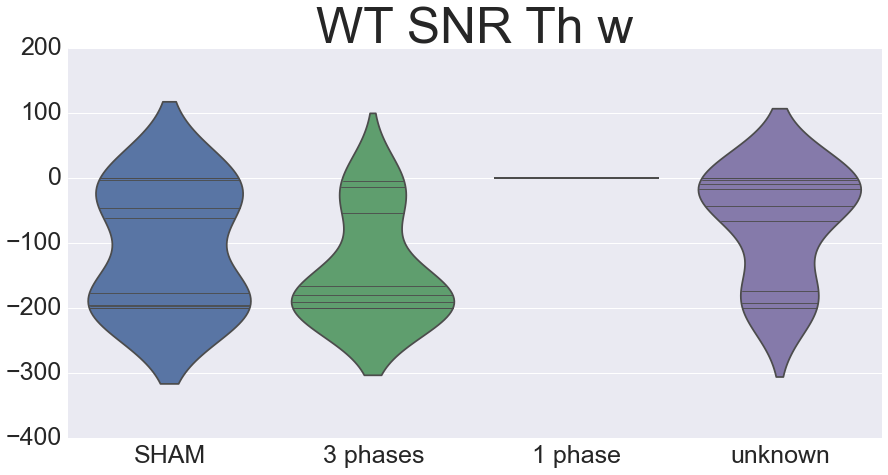

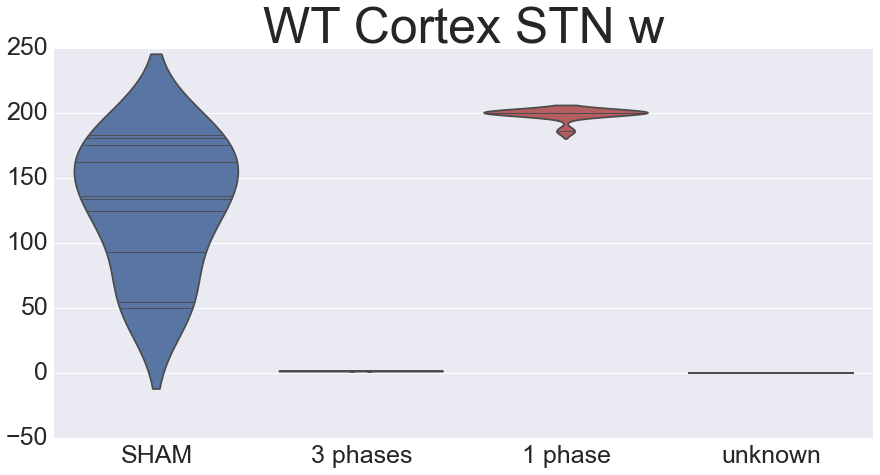

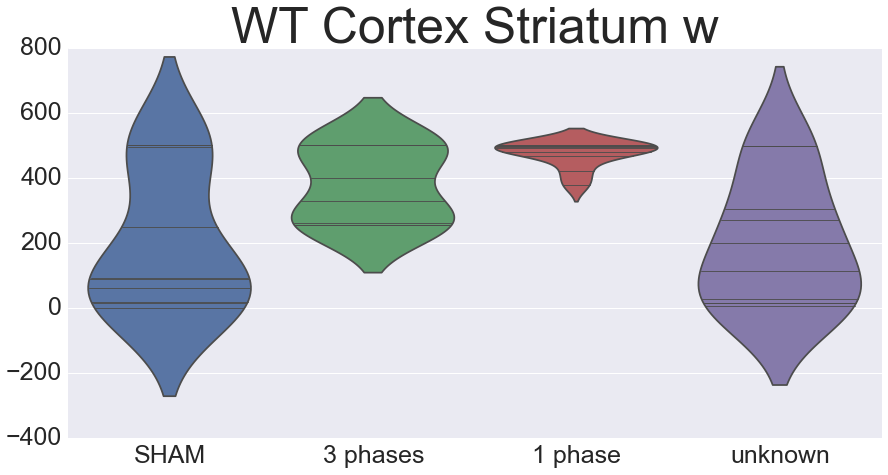

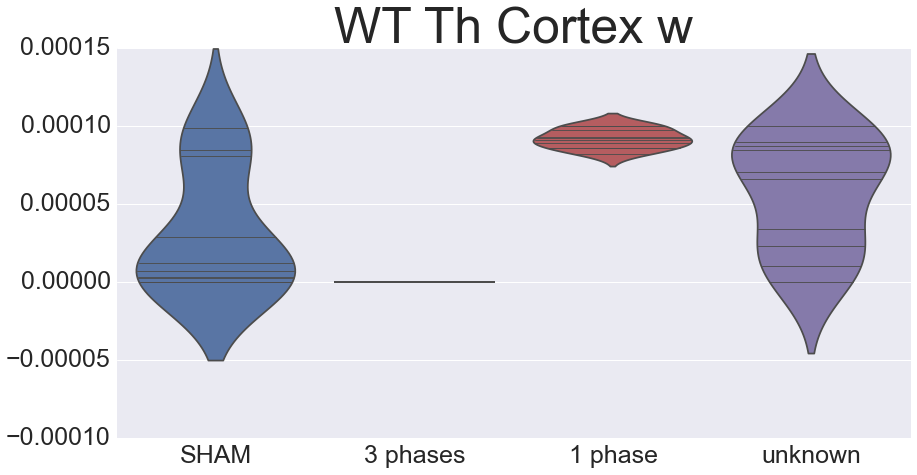

In [50]:
# For each parameters #
for i in xrange(nb_parameters_data):
    temp_df = pd.concat([df_W_concat['SHAM'].iloc[:,i],
                         df_W_concat['3_phases'].iloc[:,i],
                         df_W_concat['1_phase'].iloc[:,i],
                         df_W_concat['unknown'].iloc[:,i]],
                        axis = 1, keys = ['SHAM','3 phases','1 phase','unknown'])

    seaborn.factorplot(data=temp_df, kind='violin', scale='count', inner = 'stick', size=6, aspect = 2)
    str_temp = string.replace(df_W_concat['SHAM'].keys()[i],'_',' ')
    plt.title(str_temp, fontsize = 50)
    plt.xticks(fontsize=25)
    plt.yticks(fontsize=25)



In [51]:
# Select data
df_I0_sham = data_rep_sham.select(lambda x: re.search('^I0', x) is not None, axis=1) # I select which key start by "I0"
df_t_delay_sham = data_rep_sham.select(lambda x: re.search('t_delay$', x) is not None, axis=1)
df_tau_sham = data_rep_sham.select(lambda x: re.search('tau$', x) is not None, axis=1)

# --------------- I0 --------------- #
df_I0_sham.columns = replace_string_in_list(df_I0_sham.keys(), 'I0_', '')


# --------------- t_delay --------------- #
df_t_delay_sham_columns_temp = replace_string_in_list(df_t_delay_sham.keys(), 'WT_', '')
df_t_delay_sham_columns_temp = replace_string_in_list(df_t_delay_sham_columns_temp, '_t_delay', '')
df_t_delay_sham.columns = replace_string_in_list(df_t_delay_sham_columns_temp, '_', '->')


# --------------- tau --------------- #
df_tau_sham_columns_temp = replace_string_in_list(df_t_delay_sham.keys(), 'WT_', '')
df_tau_sham_columns_temp = replace_string_in_list(df_t_delay_sham_columns_temp, '_tau', '')
df_tau_sham.columns = replace_string_in_list(df_t_delay_sham_columns_temp, '_', '->')



(array([ -5.,   0.,   5.,  10.,  15.]), <a list of 5 Text yticklabel objects>)

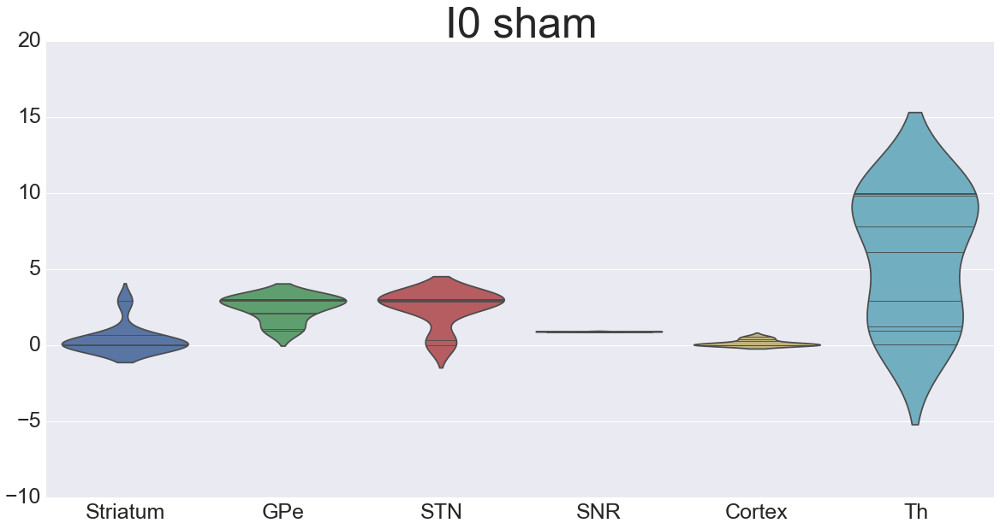

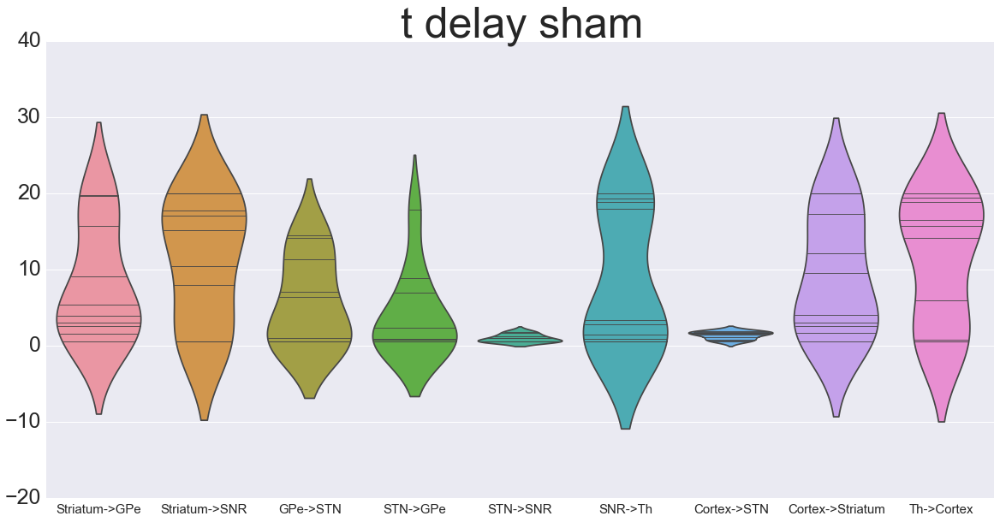

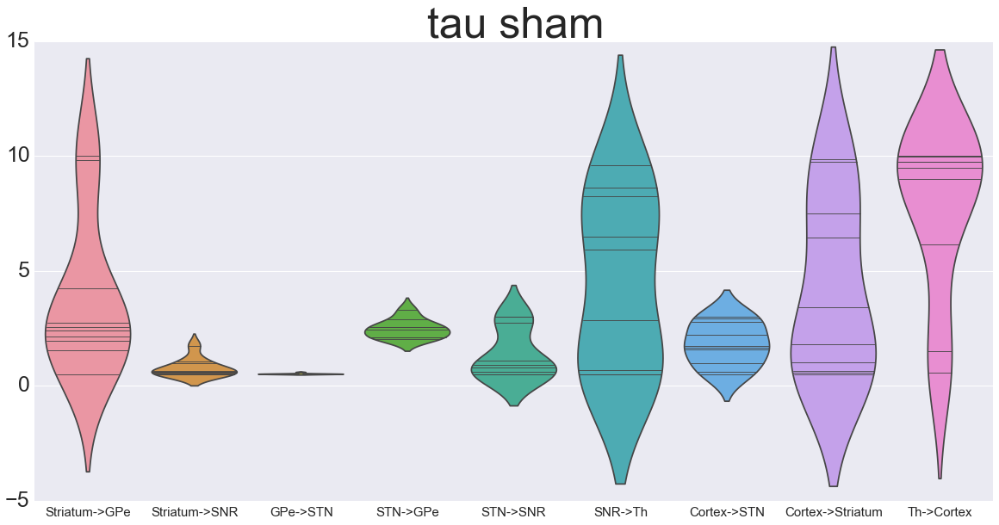

In [52]:
seaborn.factorplot(data=df_I0_sham, kind='violin', scale='count', inner = 'stick', size=8, aspect = 2)
plt.title('I0 sham', fontsize = 50)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

seaborn.factorplot(data=df_t_delay_sham, kind='violin', scale='count', inner = 'stick', size=8, aspect = 2)
plt.title('t delay sham ', fontsize = 50)
plt.xticks(fontsize=15)
plt.yticks(fontsize=25)

seaborn.factorplot(data=df_tau_sham, kind='violin', scale='count', inner = 'stick', size=8, aspect = 2)
plt.title('tau sham', fontsize = 50)
plt.xticks(fontsize=15)
plt.yticks(fontsize=25)


In [53]:
list_df_to_concat = [df_W_sham,df_W_3_phases, df_W_1_phase, df_W_unknown] # List of dataframe

df_W_concat_barplot = pd.DataFrame() # Initialisation

for df_W in list_df_to_concat: # For each dataframe
    df_W_T = df_W.T # Inverse rows and columns
    
    for column in df_W_T.columns: # For each column
        df_W_concat_barplot = pd.concat([df_W_concat_barplot, df_W_T[column]], axis = 0, ignore_index=True)
        
#print df_W_concat_barplot
    

nb_repetition = df_W_sham.shape[0] # Number of rows

# Vector of type of cell #
categ_vector = pd.Series(['SHAM']*nb_parameters_data*nb_repetition
                         +['3_phases']*nb_parameters_data*nb_repetition
                         +['1_phase']*nb_parameters_data*nb_repetition
                         +['unknown']*nb_parameters_data*nb_repetition).T
#print categ_vector


nb_condition = 4 # 4 cell types

# Vector of connexion #

list_index_values = list(df_W_sham.T.index)
list_index_values = replace_string_in_list(list_index_values, 'WT_', '')
list_index_values = replace_string_in_list(list_index_values, '_w', '')
list_index_values = replace_string_in_list(list_index_values, '_', '->')


connexion_vector = pd.Series(list_index_values*nb_condition*nb_repetition).T
#print connexion_vector

df_W_concat_barplot = pd.concat([df_W_concat_barplot,categ_vector, connexion_vector], axis = 1)

df_W_concat_barplot.columns = ['W', 'cell type', 'Connexion']
#print df_W_concat_barplot



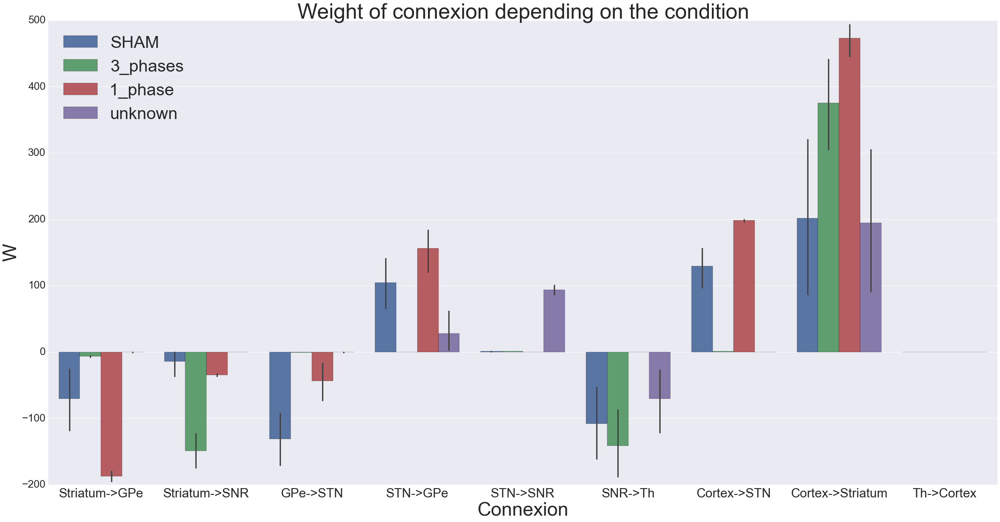

In [54]:
seaborn.factorplot(x ='Connexion', y='W', hue = 'cell type',
                   data = df_W_concat_barplot, kind='bar', size=16, aspect = 2, legend = False)
plt.title('Weight of connexion depending on the condition', fontsize = 50)
plt.xticks(fontsize=30)
plt.yticks(fontsize=25)

plt.xlabel('Connexion', fontsize=45) # To control size of the label | it erases the one of factorplot
plt.ylabel('W', fontsize=45) # To control size of the label | it erases the one of factorplot

plt.legend(loc=2,prop={'size':40}) # To control size of the legend


In [55]:
list_df_to_concat_ratio = [df/df_W_sham.mean() for df in list_df_to_concat]

df_W_concat_ratio_barplot = pd.DataFrame() # Initialisation

for df_W in list_df_to_concat_ratio: # For each dataframe
    df_W_T = df_W.T # Inverse rows and columns
    
    for column in df_W_T.columns: # For each column
        df_W_concat_ratio_barplot = pd.concat([df_W_concat_ratio_barplot, df_W_T[column]], axis = 0, ignore_index=True)
        
#print df_W_concat_barplot


df_W_concat_ratio_barplot = pd.concat([df_W_concat_ratio_barplot,categ_vector, connexion_vector], axis = 1)

df_W_concat_ratio_barplot.columns = ['W', 'cell type', 'Connexion']
#print df_W_concat_barplot




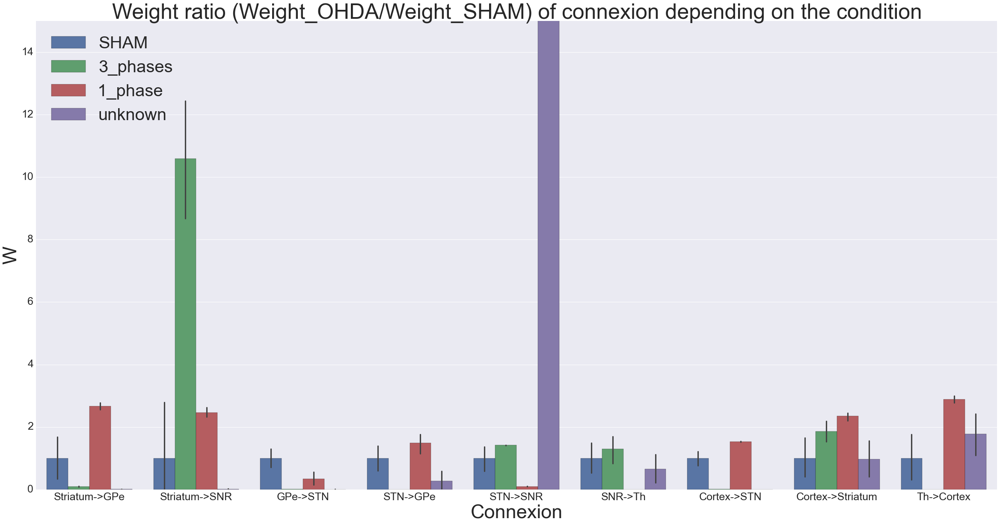

In [56]:
axes = seaborn.factorplot(x ='Connexion', y='W', hue = 'cell type',
                   data = df_W_concat_ratio_barplot, kind='bar', size=16, aspect = 2, legend = False)
plt.title('Weight ratio (Weight_OHDA/Weight_SHAM) of connexion depending on the condition', fontsize = 50)
plt.xticks(fontsize=25)
plt.yticks(fontsize=25)

plt.xlabel('Connexion', fontsize=45) # To control size of the label | it erases the one of factorplot
plt.ylabel('W', fontsize=45) # To control size of the label | it erases the one of factorplot

plt.legend(loc=2,prop={'size':40}) # To control size of the legend

axes.set(ylim=(0,15)) # To set axes limits